# 🎨 AI Style Transfer in 4K
### Transform your photos into stunning artwork using TensorFlow Hub
- Supports **high-quality 4K output**
- Includes **sharpening, tiling, and final anime polishing**
- Kaggle-ready for **publishing and sharing**


In [1]:
# ============================
# 📦 1. IMPORTS & SETUP
# ============================
import tensorflow as tf
import tensorflow_hub as hub
import numpy as np
import matplotlib.pyplot as plt
import PIL.Image
import cv2

print("✅ TensorFlow version:", tf.__version__)
print("✅ TensorFlow Hub version:", hub.__version__)

2025-08-06 12:29:53.346793: E external/local_xla/xla/stream_executor/cuda/cuda_fft.cc:477] Unable to register cuFFT factory: Attempting to register factory for plugin cuFFT when one has already been registered
E0000 00:00:1754483393.551528      36 cuda_dnn.cc:8310] Unable to register cuDNN factory: Attempting to register factory for plugin cuDNN when one has already been registered
E0000 00:00:1754483393.607619      36 cuda_blas.cc:1418] Unable to register cuBLAS factory: Attempting to register factory for plugin cuBLAS when one has already been registered


✅ TensorFlow version: 2.18.0
✅ TensorFlow Hub version: 0.16.1


In [2]:
# ============================
# 🔧 2. HELPER FUNCTIONS
# ============================

def load_image(image_path, max_dim=1024):
    img = tf.io.read_file(image_path)
    img = tf.image.decode_image(img, channels=3)
    img = tf.image.convert_image_dtype(img, tf.float32)
    shape = tf.cast(tf.shape(img)[:-1], tf.float32)
    long_dim = max(shape)
    scale = max_dim / long_dim
    new_shape = tf.cast(shape * scale, tf.int32)
    img = tf.image.resize(img, new_shape)
    return img[tf.newaxis, :]  # Add batch dimension

def tensor_to_image(tensor):
    tensor = tf.clip_by_value(tensor, 0.0, 1.0)
    tensor = tensor * 255
    tensor = np.array(tensor, dtype=np.uint8)
    if np.ndim(tensor) > 3 and tensor.shape[0] == 1:
        tensor = tensor[0]
    return PIL.Image.fromarray(tensor)

def sharpen_image(pil_img):
    """Basic sharpening filter"""
    img = np.array(pil_img)
    kernel = np.array([[0,-1,0],
                       [-1,5,-1],
                       [0,-1,0]])
    sharpened = cv2.filter2D(img, -1, kernel)
    return PIL.Image.fromarray(sharpened)

def upscale_image(pil_img, scale=2):
    """Simple upscale"""
    w, h = pil_img.size
    return pil_img.resize((w*scale, h*scale), PIL.Image.LANCZOS)

def tiled_upscale(pil_img, scale=2, tile_size=512):
    """Upscale large images by tiling to avoid OOM"""
    w, h = pil_img.size
    new_w, new_h = w * scale, h * scale
    result = PIL.Image.new("RGB", (new_w, new_h))
    img_np = np.array(pil_img)

    for y in range(0, h, tile_size):
        for x in range(0, w, tile_size):
            tile = img_np[y:y+tile_size, x:x+tile_size]
            tile_pil = PIL.Image.fromarray(tile)
            tile_up = tile_pil.resize((tile.shape[1]*scale, tile.shape[0]*scale), PIL.Image.LANCZOS)
            result.paste(tile_up, (x*scale, y*scale))
    return result

def anime_polish(pil_img):
    """✨ Final anime-style polish: smooth + sharpen edges"""
    img = np.array(pil_img)
    smooth = cv2.bilateralFilter(img, d=9, sigmaColor=75, sigmaSpace=75)
    edges = cv2.Canny(smooth, 50, 150)
    edges_colored = cv2.cvtColor(edges, cv2.COLOR_GRAY2RGB)
    polished = cv2.addWeighted(smooth, 0.9, edges_colored, 0.2, 0)
    return PIL.Image.fromarray(polished)

In [3]:
# ============================
# 🤖 3. LOAD STYLE TRANSFER MODEL
# ============================
hub_model = hub.load("https://tfhub.dev/google/magenta/arbitrary-image-stylization-v1-256/2")
print("✅ Model loaded successfully!")

I0000 00:00:1754483410.998607      36 gpu_device.cc:2022] Created device /job:localhost/replica:0/task:0/device:GPU:0 with 13942 MB memory:  -> device: 0, name: Tesla T4, pci bus id: 0000:00:04.0, compute capability: 7.5
I0000 00:00:1754483410.999388      36 gpu_device.cc:2022] Created device /job:localhost/replica:0/task:0/device:GPU:1 with 13942 MB memory:  -> device: 1, name: Tesla T4, pci bus id: 0000:00:05.0, compute capability: 7.5


✅ Model loaded successfully!


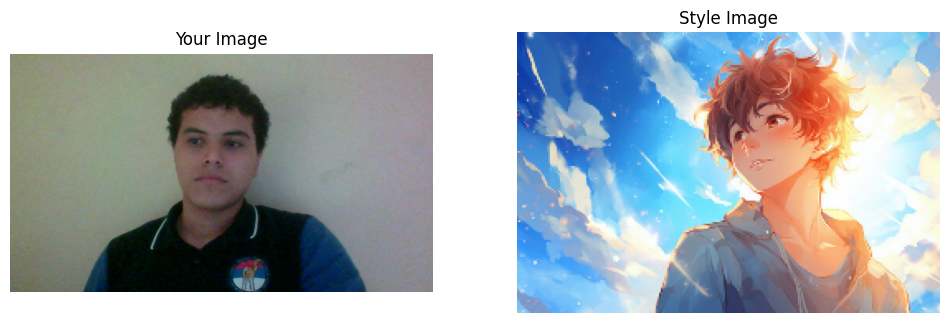

In [4]:
# ============================
# 🖼️ 4. LOAD CONTENT & STYLE IMAGES
# ============================
content_path = '/kaggle/input/yourphoto/WIN_20250804_15_11_27_Pro.jpg'
style_path = '/kaggle/input/animestyle/360_F_622221708_Gg16ZdaNSixeaIORq9MuuT4w9VWTkYw4.jpg'

content_image = load_image(content_path, max_dim=1024)
style_image   = load_image(style_path,   max_dim=256)

plt.figure(figsize=(12,6))
plt.subplot(1,2,1); plt.imshow(tf.squeeze(content_image)); plt.axis('off'); plt.title("Your Image")
plt.subplot(1,2,2); plt.imshow(tf.squeeze(style_image)); plt.axis('off'); plt.title("Style Image")
plt.show()

In [5]:
# ============================
# 🎨 5. APPLY STYLE TRANSFER
# ============================
stylized_image = hub_model(tf.constant(content_image), tf.constant(style_image))[0]
result_image = tensor_to_image(stylized_image)
result_image.show()

I0000 00:00:1754483415.574909     102 cuda_dnn.cc:529] Loaded cuDNN version 90300


Error: no "view" mailcap rules found for type "image/png"
/usr/bin/xdg-open: 882: www-browser: not found
/usr/bin/xdg-open: 882: links2: not found
/usr/bin/xdg-open: 882: elinks: not found
/usr/bin/xdg-open: 882: links: not found
/usr/bin/xdg-open: 882: lynx: not found
/usr/bin/xdg-open: 882: w3m: not found
xdg-open: no method available for opening '/tmp/tmpeznp8mf8.PNG'


✅ Final 4K -style image saved!


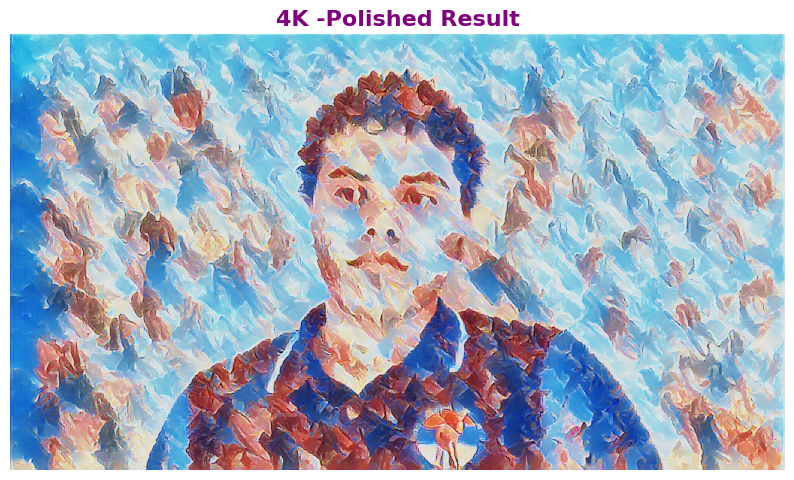

In [6]:
# ============================
# 🌟 6. ENHANCE & POLISH RESULT
# ============================
sharpened_image = sharpen_image(result_image)
upscaled_4k = tiled_upscale(sharpened_image, scale=2, tile_size=512)
polished_final = anime_polish(upscaled_4k)

# Save for Kaggle output
polished_final.save("stylized_result_4K_Anime.jpg", quality=95)
print("✅ Final 4K -style image saved!")

# Display final
plt.figure(figsize=(10,10))
plt.imshow(polished_final)
plt.axis('off')
plt.title("4K -Polished Result", fontsize=16, fontweight='bold', color='purple')
plt.show()


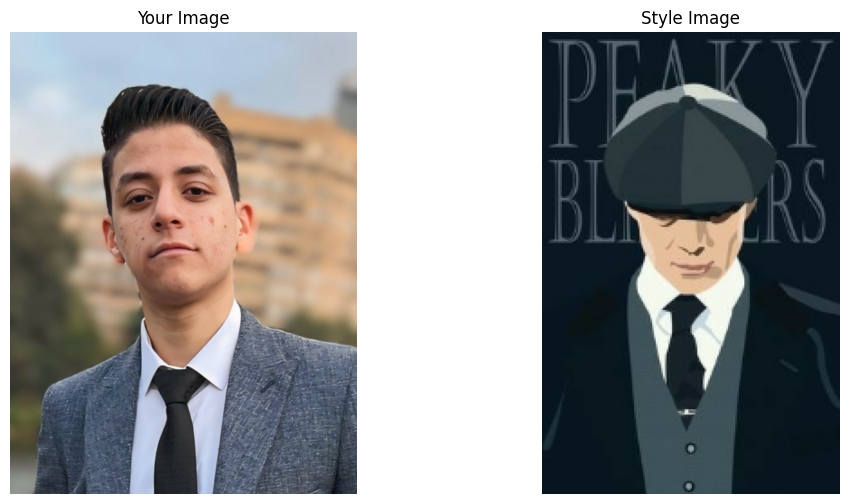

In [7]:
# ============================
# 🖼️ 4. LOAD CONTENT & STYLE IMAGES
# ============================
content_path = '/kaggle/input/hameddd/WhatsApp Image 2025-08-06 at 14.58.08_8f4b2bc2.jpg'
style_path = '/kaggle/input/haaaaamed-style/WhatsApp Image 2025-08-06 at 15.00.13_1eff3efd.jpg'

content_image = load_image(content_path, max_dim=1024)
style_image   = load_image(style_path,   max_dim=256)

plt.figure(figsize=(12,6))
plt.subplot(1,2,1); plt.imshow(tf.squeeze(content_image)); plt.axis('off'); plt.title("Your Image")
plt.subplot(1,2,2); plt.imshow(tf.squeeze(style_image)); plt.axis('off'); plt.title("Style Image")
plt.show()

In [8]:
# ============================
# 🎨 5. APPLY STYLE TRANSFER
# ============================
stylized_image = hub_model(tf.constant(content_image), tf.constant(style_image))[0]
result_image = tensor_to_image(stylized_image)
result_image.show()

Error: no "view" mailcap rules found for type "image/png"
/usr/bin/xdg-open: 882: www-browser: not found
/usr/bin/xdg-open: 882: links2: not found
/usr/bin/xdg-open: 882: elinks: not found
/usr/bin/xdg-open: 882: links: not found
/usr/bin/xdg-open: 882: lynx: not found
/usr/bin/xdg-open: 882: w3m: not found
xdg-open: no method available for opening '/tmp/tmpdlt0bak0.PNG'


✅ Final 4K -style image saved!


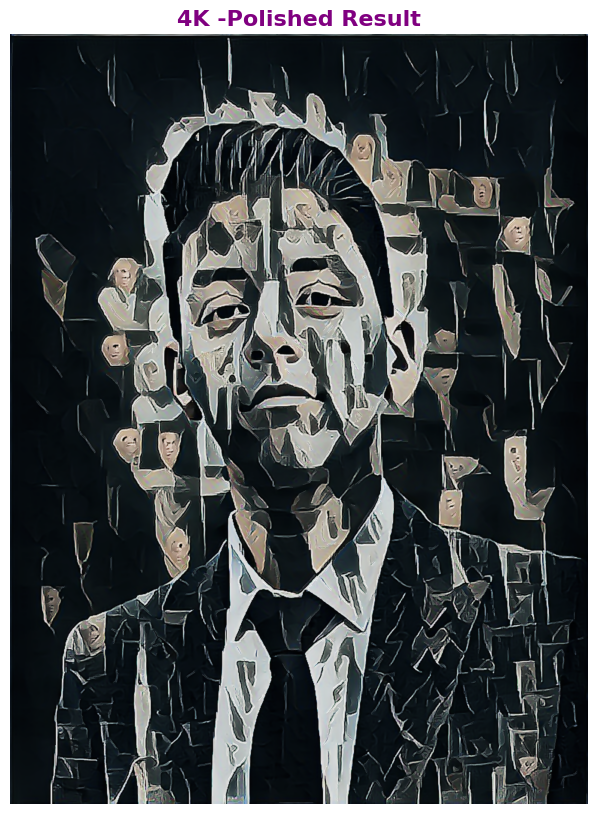

In [9]:
# ============================
# 🌟 6. ENHANCE & POLISH RESULT
# ============================
sharpened_image = sharpen_image(result_image)
upscaled_4k = tiled_upscale(sharpened_image, scale=2, tile_size=512)
polished_final = anime_polish(upscaled_4k)

# Save for Kaggle output
polished_final.save("stylized_result_4K_Anime.jpg", quality=95)
print("✅ Final 4K -style image saved!")

# Display final
plt.figure(figsize=(10,10))
plt.imshow(polished_final)
plt.axis('off')
plt.title("4K -Polished Result", fontsize=16, fontweight='bold', color='purple')
plt.show()


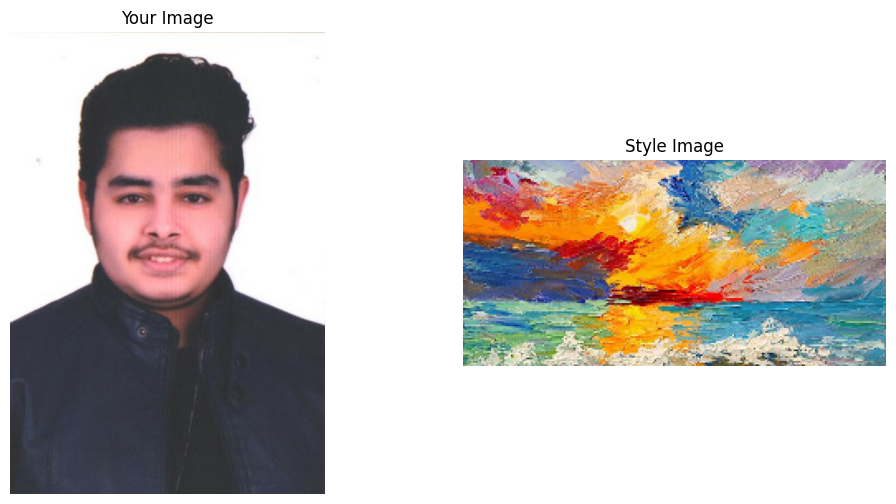

In [10]:
# ============================
# 🖼️ 4. LOAD CONTENT & STYLE IMAGES
# ============================
content_path = '/kaggle/input/aymandata/WhatsApp Image 2025-08-06 at 15.00.15_12de5cfe.jpg'
style_path = '/kaggle/input/aymanstyle/b7782b_d7fd195111d942b393c2196d2e6decc3mv2.jpg'

content_image = load_image(content_path, max_dim=1024)
style_image   = load_image(style_path,   max_dim=256)

plt.figure(figsize=(12,6))
plt.subplot(1,2,1); plt.imshow(tf.squeeze(content_image)); plt.axis('off'); plt.title("Your Image")
plt.subplot(1,2,2); plt.imshow(tf.squeeze(style_image)); plt.axis('off'); plt.title("Style Image")
plt.show()

In [11]:
# ============================
# 🎨 5. APPLY STYLE TRANSFER
# ============================
stylized_image = hub_model(tf.constant(content_image), tf.constant(style_image))[0]
result_image = tensor_to_image(stylized_image)
result_image.show()

Error: no "view" mailcap rules found for type "image/png"
/usr/bin/xdg-open: 882: www-browser: not found
/usr/bin/xdg-open: 882: links2: not found
/usr/bin/xdg-open: 882: elinks: not found
/usr/bin/xdg-open: 882: links: not found
/usr/bin/xdg-open: 882: lynx: not found
/usr/bin/xdg-open: 882: w3m: not found
xdg-open: no method available for opening '/tmp/tmpexmaq5kj.PNG'


✅ Final 4K -style image saved!


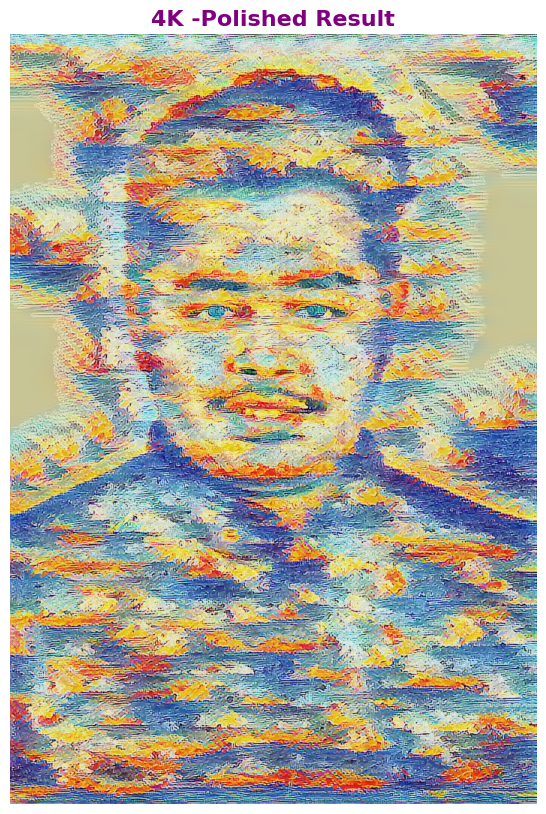

In [12]:
# ============================
# 🌟 6. ENHANCE & POLISH RESULT
# ============================
sharpened_image = sharpen_image(result_image)
upscaled_4k = tiled_upscale(sharpened_image, scale=2, tile_size=512)
polished_final = anime_polish(upscaled_4k)

# Save for Kaggle output
polished_final.save("stylized_result_4K_Anime.jpg", quality=95)
print("✅ Final 4K -style image saved!")

# Display final
plt.figure(figsize=(10,10))
plt.imshow(polished_final)
plt.axis('off')
plt.title("4K -Polished Result", fontsize=16, fontweight='bold', color='purple')
plt.show()


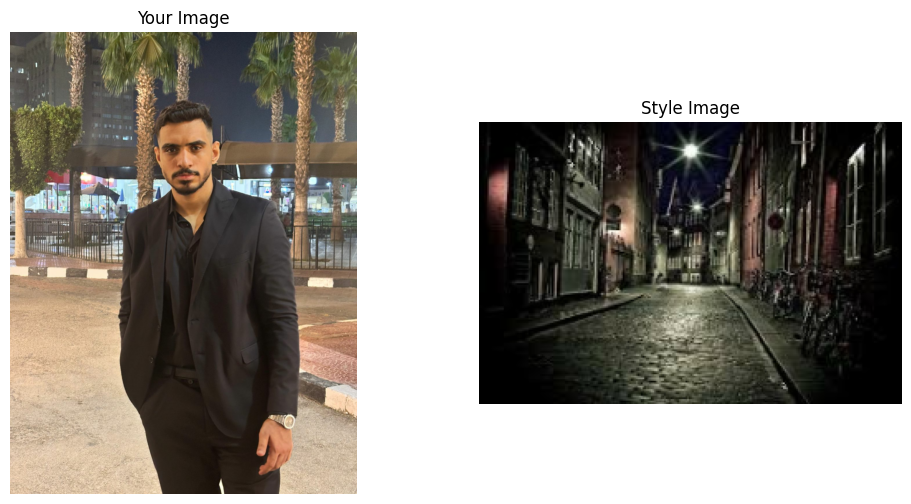

In [26]:
# ============================
# 🖼️ 4. LOAD CONTENT & STYLE IMAGES
# ============================
content_path = '/kaggle/input/omarelsayed/WhatsApp Image 2025-08-06 at 15.32.06_765e5b45.jpg'
style_path = '/kaggle/input/omarelsayed-style/WhatsApp Image 2025-08-06 at 15.33.15_32b3e6ce.jpg'

content_image = load_image(content_path, max_dim=1024)
style_image   = load_image(style_path,   max_dim=256)

plt.figure(figsize=(12,6))
plt.subplot(1,2,1); plt.imshow(tf.squeeze(content_image)); plt.axis('off'); plt.title("Your Image")
plt.subplot(1,2,2); plt.imshow(tf.squeeze(style_image)); plt.axis('off'); plt.title("Style Image")
plt.show()

In [27]:
# ============================
# 🎨 5. APPLY STYLE TRANSFER
# ============================
stylized_image = hub_model(tf.constant(content_image), tf.constant(style_image))[0]
result_image = tensor_to_image(stylized_image)
result_image.show()

Error: no "view" mailcap rules found for type "image/png"
/usr/bin/xdg-open: 882: www-browser: not found
/usr/bin/xdg-open: 882: links2: not found
/usr/bin/xdg-open: 882: elinks: not found
/usr/bin/xdg-open: 882: links: not found
/usr/bin/xdg-open: 882: lynx: not found
/usr/bin/xdg-open: 882: w3m: not found
xdg-open: no method available for opening '/tmp/tmpad9nvn58.PNG'


✅ Final 4K -style image saved!


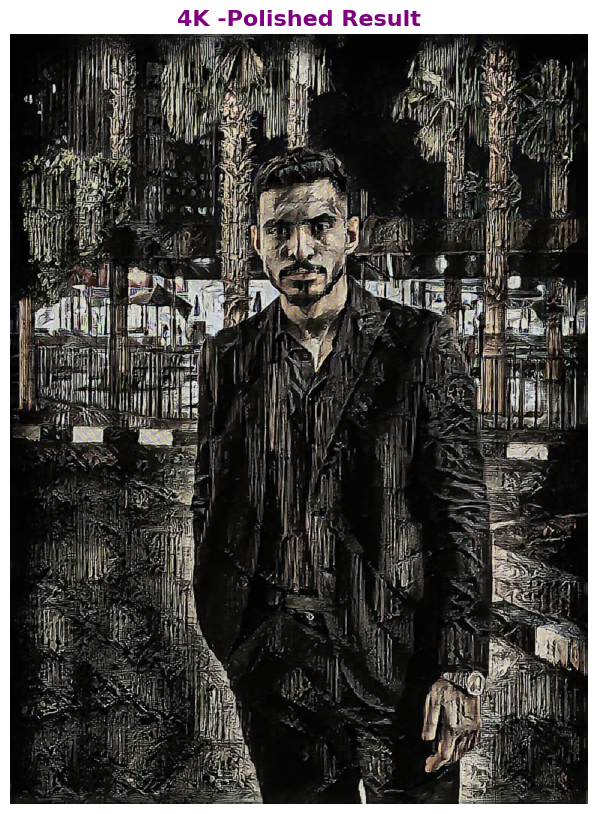

In [28]:
# ============================
# 🌟 6. ENHANCE & POLISH RESULT
# ============================
sharpened_image = sharpen_image(result_image)
upscaled_4k = tiled_upscale(sharpened_image, scale=2, tile_size=512)
polished_final = anime_polish(upscaled_4k)

# Save for Kaggle output
polished_final.save("stylized_result_4K_Anime.jpg", quality=95)
print("✅ Final 4K -style image saved!")

# Display final
plt.figure(figsize=(10,10))
plt.imshow(polished_final)
plt.axis('off')
plt.title("4K -Polished Result", fontsize=16, fontweight='bold', color='purple')
plt.show()


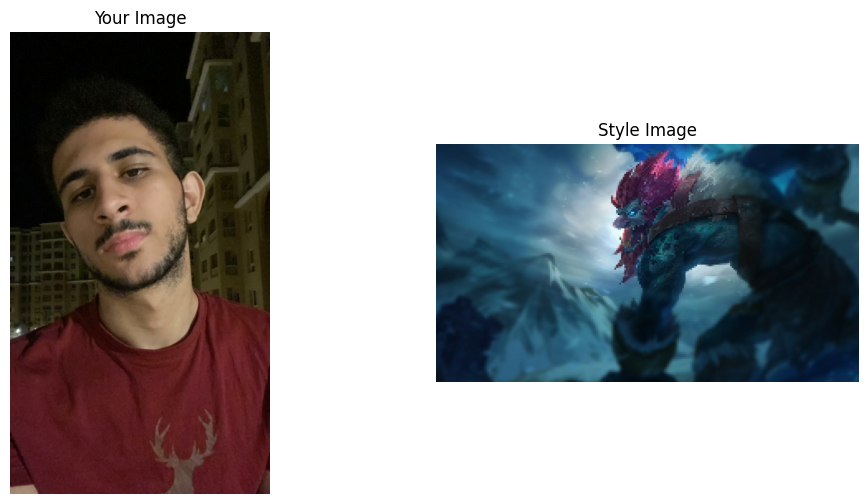

In [29]:
# ============================
# 🖼️ 4. LOAD CONTENT & STYLE IMAGES
# ============================
content_path = '/kaggle/input/taitokitrundle/WhatsApp Image 2025-08-06 at 15.39.19_5a75172a.jpg'
style_path = '/kaggle/input/taitokitrundle/WhatsApp Image 2025-08-06 at 15.40.04_1def45be.jpg'

content_image = load_image(content_path, max_dim=1024)
style_image   = load_image(style_path,   max_dim=256)

plt.figure(figsize=(12,6))
plt.subplot(1,2,1); plt.imshow(tf.squeeze(content_image)); plt.axis('off'); plt.title("Your Image")
plt.subplot(1,2,2); plt.imshow(tf.squeeze(style_image)); plt.axis('off'); plt.title("Style Image")
plt.show()

In [30]:
# ============================
# 🎨 5. APPLY STYLE TRANSFER
# ============================
stylized_image = hub_model(tf.constant(content_image), tf.constant(style_image))[0]
result_image = tensor_to_image(stylized_image)
result_image.show()

Error: no "view" mailcap rules found for type "image/png"
/usr/bin/xdg-open: 882: www-browser: not found
/usr/bin/xdg-open: 882: links2: not found
/usr/bin/xdg-open: 882: elinks: not found
/usr/bin/xdg-open: 882: links: not found
/usr/bin/xdg-open: 882: lynx: not found
/usr/bin/xdg-open: 882: w3m: not found
xdg-open: no method available for opening '/tmp/tmp4w0jd52x.PNG'


✅ Final 4K -style image saved!


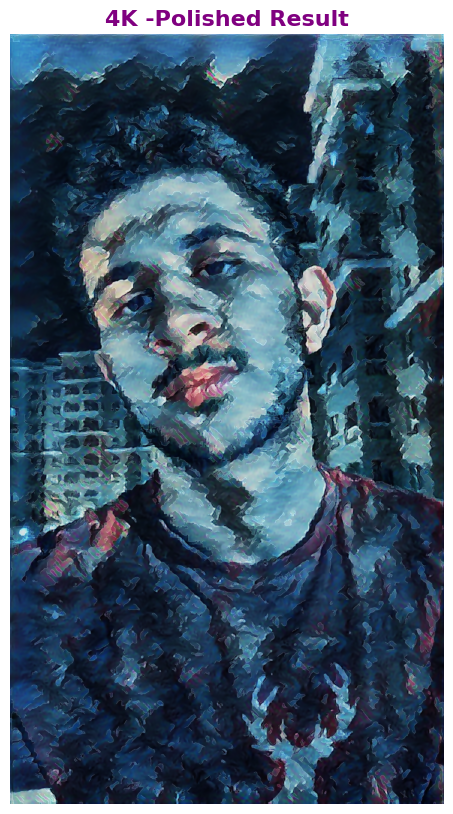

In [31]:
# ============================
# 🌟 6. ENHANCE & POLISH RESULT
# ============================
sharpened_image = sharpen_image(result_image)
upscaled_4k = tiled_upscale(sharpened_image, scale=2, tile_size=512)
polished_final = anime_polish(upscaled_4k)

# Save for Kaggle output
polished_final.save("stylized_result_4K_Anime.jpg", quality=95)
print("✅ Final 4K -style image saved!")

# Display final
plt.figure(figsize=(10,10))
plt.imshow(polished_final)
plt.axis('off')
plt.title("4K -Polished Result", fontsize=16, fontweight='bold', color='purple')
plt.show()


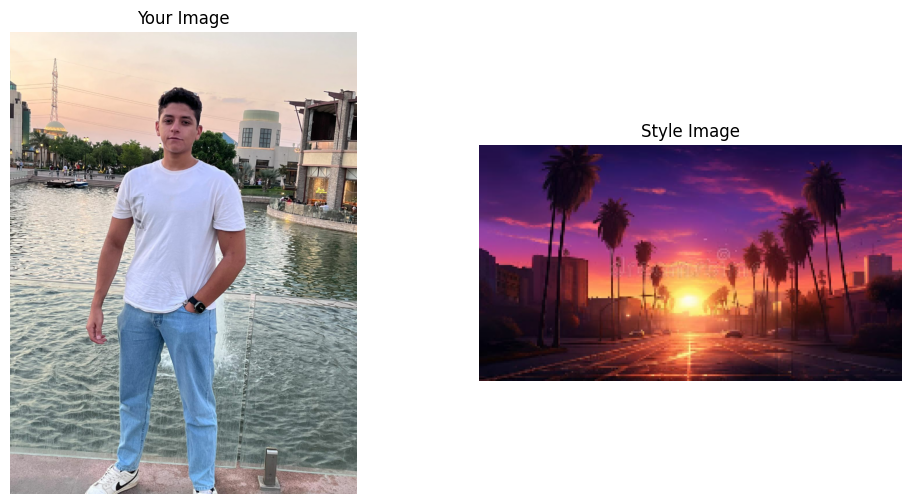

In [77]:
# ============================
# 🖼️ 4. LOAD CONTENT & STYLE IMAGES
# ============================
content_path = '/kaggle/input/omar77777777777777777/WhatsApp Image 2025-08-06 at 15.59.20_5fcb18fc.jpg'
style_path = '/kaggle/input/ggggggg5646546/ai-generated-illustration-empty-road-illuminated-evening-light-glowing-sunset-tall-palm-trees-gta-style-303513017.jpg'

content_image = load_image(content_path, max_dim=1024)
style_image   = load_image(style_path,   max_dim=256)

plt.figure(figsize=(12,6))
plt.subplot(1,2,1); plt.imshow(tf.squeeze(content_image)); plt.axis('off'); plt.title("Your Image")
plt.subplot(1,2,2); plt.imshow(tf.squeeze(style_image)); plt.axis('off'); plt.title("Style Image")
plt.show()

In [78]:
# ============================
# 🎨 5. APPLY STYLE TRANSFER
# ============================
stylized_image = hub_model(tf.constant(content_image), tf.constant(style_image))[0]
result_image = tensor_to_image(stylized_image)
result_image.show()

Error: no "view" mailcap rules found for type "image/png"
/usr/bin/xdg-open: 882: www-browser: not found
/usr/bin/xdg-open: 882: links2: not found
/usr/bin/xdg-open: 882: elinks: not found
/usr/bin/xdg-open: 882: links: not found
/usr/bin/xdg-open: 882: lynx: not found
/usr/bin/xdg-open: 882: w3m: not found
xdg-open: no method available for opening '/tmp/tmpxxkt3nft.PNG'


✅ Final 4K -style image saved!


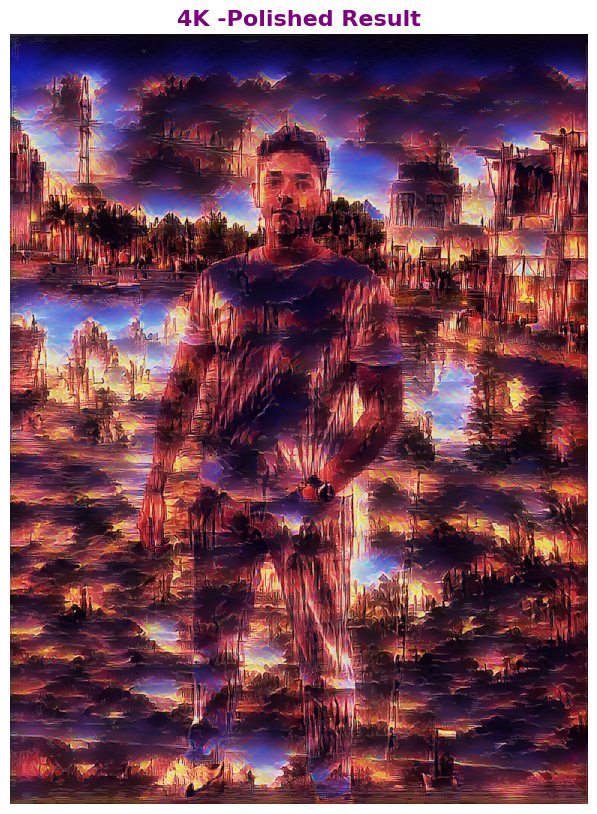

In [79]:
# ============================
# 🌟 6. ENHANCE & POLISH RESULT
# ============================
sharpened_image = sharpen_image(result_image)
upscaled_4k = tiled_upscale(sharpened_image, scale=2, tile_size=512)
polished_final = anime_polish(upscaled_4k)

# Save for Kaggle output
polished_final.save("stylized_result_4K_Anime.jpg", quality=95)
print("✅ Final 4K -style image saved!")

# Display final
plt.figure(figsize=(10,10))
plt.imshow(polished_final)
plt.axis('off')
plt.title("4K -Polished Result", fontsize=16, fontweight='bold', color='purple')
plt.show()

In [13]:
import os

content_paths = [
    "/kaggle/input/big-data/Data/TestCases/22714.jpg",
    "/kaggle/input/big-data/Data/TestCases/37864.jpg",
    "/kaggle/input/big-data/Data/TestCases/5726.jpg",
]

style_paths = [
    "/kaggle/input/big-data/Data/Artworks/108700.jpg",
    "/kaggle/input/big-data/Data/Artworks/428771.jpg",
    "/kaggle/input/big-data/Data/Artworks/673478.png",
]

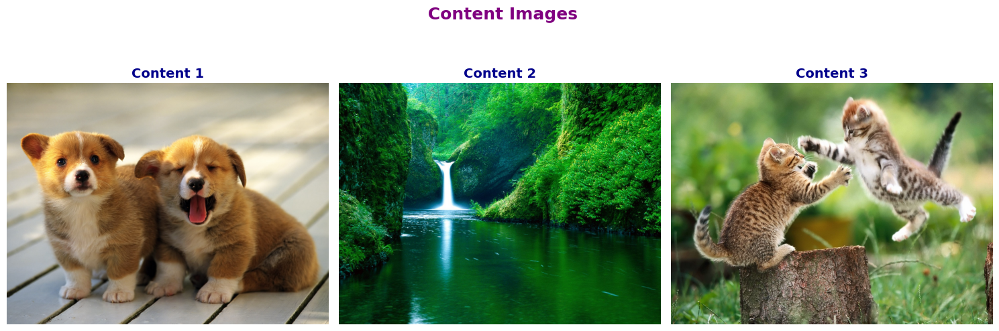

In [14]:
import matplotlib.pyplot as plt

# Show all content images
plt.figure(figsize=(15, 5))
for idx, path in enumerate(content_paths):
    img = plt.imread(path)
    plt.subplot(1, len(content_paths), idx + 1)
    plt.imshow(img)
    plt.axis('off')
    plt.title(f"Content {idx+1}", fontsize=14, fontweight='bold', color='darkblue')
plt.suptitle(" Content Images", fontsize=18, fontweight='bold', color='purple', y=1.05)
plt.tight_layout()
plt.show()

/tmp/ipykernel_36/3276293710.py:10: UserWarning: Glyph 127912 (\N{ARTIST PALETTE}) missing from current font.
  plt.tight_layout()
/usr/local/lib/python3.11/dist-packages/IPython/core/pylabtools.py:151: UserWarning: Glyph 127912 (\N{ARTIST PALETTE}) missing from current font.
  fig.canvas.print_figure(bytes_io, **kw)


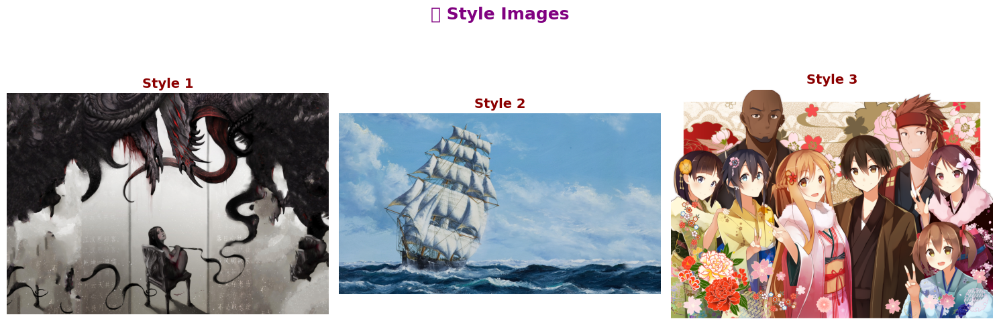

In [15]:
# Show all style images
plt.figure(figsize=(15, 5))
for idx, path in enumerate(style_paths):
    img = plt.imread(path)
    plt.subplot(1, len(style_paths), idx + 1)
    plt.imshow(img)
    plt.axis('off')
    plt.title(f"Style {idx+1}", fontsize=14, fontweight='bold', color='darkred')
plt.suptitle("🎨 Style Images", fontsize=18, fontweight='bold', color='purple', y=1.05)
plt.tight_layout()
plt.show()

In [16]:
import os

# Create output folder
os.makedirs("multi_results", exist_ok=True)

results = []
for c_idx, content_path in enumerate(content_paths):
    for s_idx, style_path in enumerate(style_paths):
        # Load images
        content_image = load_image(content_path, max_dim=1024)
        style_image = load_image(style_path, max_dim=256)
        
        # Style transfer
        stylized_image = hub_model(tf.constant(content_image), tf.constant(style_image))[0]
        result_image = tensor_to_image(stylized_image)
        
        # Enhance and polish
        sharpened = sharpen_image(result_image)
        upscaled = tiled_upscale(sharpened, scale=2, tile_size=512)
        polished = anime_polish(upscaled)
        
        # Save output
        filename = f"multi_results/content{c_idx+1}_style{s_idx+1}.jpg"
        polished.save(filename, quality=95)
        
        results.append((content_path, style_path, filename))

print("✅ All stylized results saved in `multi_results/` folder!")

✅ All stylized results saved in `multi_results/` folder!


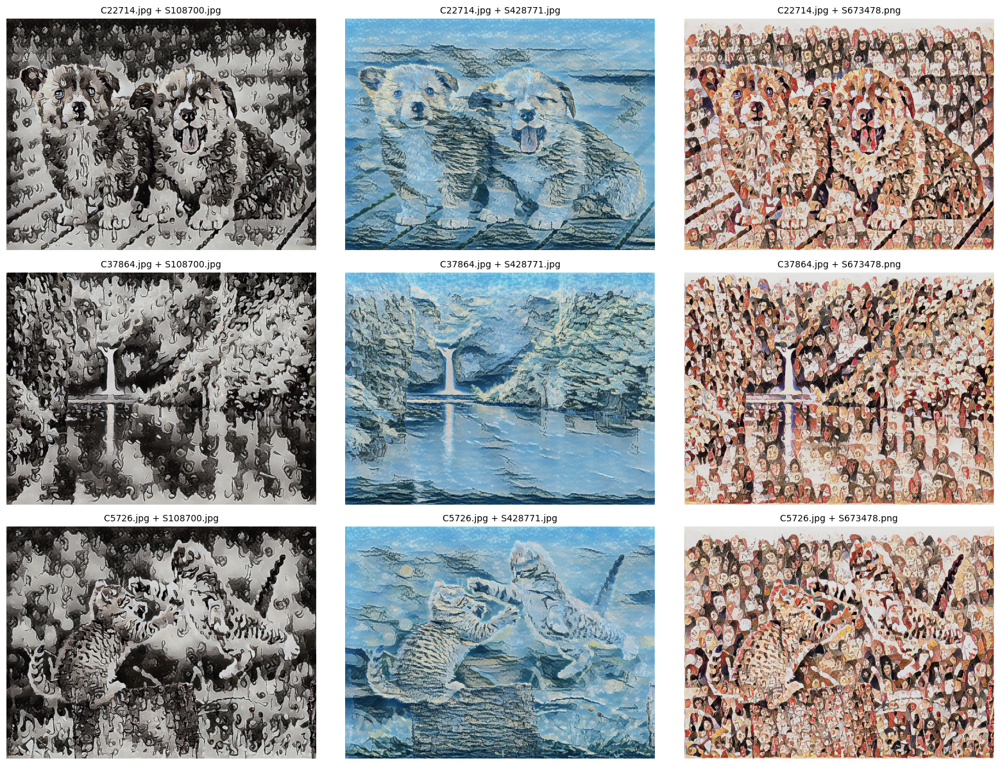

In [17]:
# Display all results in a nice grid
cols = 3  # number of columns in the grid
plt.figure(figsize=(16, 16))
for idx, (c, s, r) in enumerate(results):
    img = plt.imread(r)
    plt.subplot(len(results)//cols + 1, cols, idx + 1)
    plt.imshow(img)
    plt.axis('off')
    plt.title(f"C{c.split('/')[-1]} + S{s.split('/')[-1]}", fontsize=10)
plt.tight_layout()
plt.show()

Found 5 content images and 5 style images.


/tmp/ipykernel_36/2850377069.py:23: UserWarning: Glyph 128444 (\N{FRAME WITH PICTURE}) missing from current font.
  plt.tight_layout()
/usr/local/lib/python3.11/dist-packages/IPython/core/pylabtools.py:151: UserWarning: Glyph 128444 (\N{FRAME WITH PICTURE}) missing from current font.
  fig.canvas.print_figure(bytes_io, **kw)


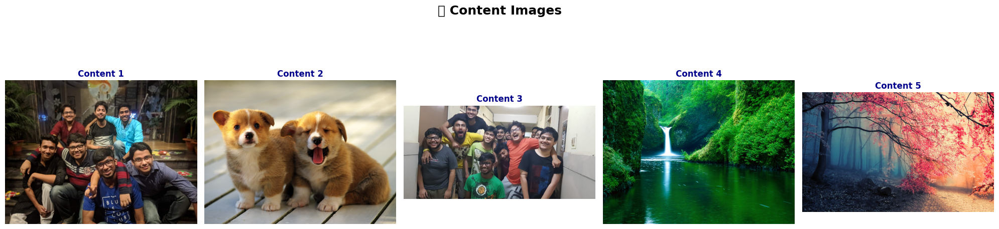

/tmp/ipykernel_36/2850377069.py:37: UserWarning: Glyph 127912 (\N{ARTIST PALETTE}) missing from current font.
  plt.tight_layout()


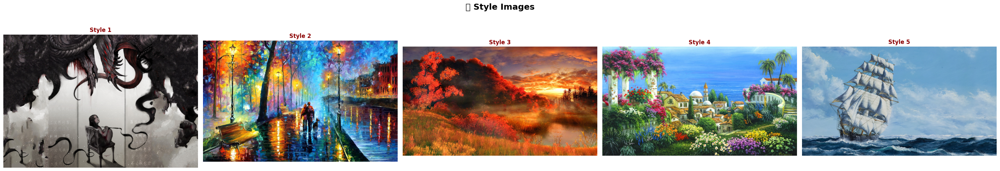

In [18]:
import glob
import matplotlib.pyplot as plt

# -----------------------
# 1️⃣ Collect image paths
# -----------------------
content_paths = sorted(glob.glob("/kaggle/input/big-data/Data/TestCases/*"))[:5]
style_paths   = sorted(glob.glob("/kaggle/input/big-data/Data/Artworks/*"))[:5]

print(f"Found {len(content_paths)} content images and {len(style_paths)} style images.")

# -----------------------
# 2️⃣ Display content images
# -----------------------
plt.figure(figsize=(20, 5))
for idx, path in enumerate(content_paths):
    img = plt.imread(path)
    plt.subplot(1, len(content_paths), idx + 1)
    plt.imshow(img)
    plt.axis('off')
    plt.title(f"Content {idx+1}", fontsize=12, fontweight='bold', color='darkblue')
plt.suptitle("🖼️ Content Images", fontsize=18, fontweight='bold', y=1.05)
plt.tight_layout()
plt.show()

# -----------------------
# 3️⃣ Display style images
# -----------------------
plt.figure(figsize=(30, 5))
for idx, path in enumerate(style_paths):
    img = plt.imread(path)
    plt.subplot(1, len(style_paths), idx + 1)
    plt.imshow(img)
    plt.axis('off')
    plt.title(f"Style {idx+1}", fontsize=12, fontweight='bold', color='darkred')
plt.suptitle("🎨 Style Images", fontsize=18, fontweight='bold', y=1.05)
plt.tight_layout()
plt.show()

# 🎉 Done! Your Photo is Now a 4K Anime Masterpiece 🎉

### ✨ Features of this Notebook
- **High-Resolution 4K Anime Style Transfer**  
- **Automatic Sharpening, Tiling, and Polishing** for professional results  
- **Edge Enhancement + Smooth Filter** for a true anime look  
- **Kaggle-ready, clean, and well-organized**  

---

### 📌 Tips for Best Results:
- Use **clear and high-quality content photos**.
- Pick a **style image with strong colors or outlines** for best anime effects.
- Adjust the **`max_dim`** in the code if your GPU allows bigger inputs.

---

### ⭐ Support & Share
If you liked this notebook:  
- **Give it an upvote 👍** to help others discover it  
- **Fork & try with your own photos!**  

---

### 📢 Output
Check `stylized_result_4K_Anime.jpg` in the output files for your polished 4K anime art!